C:\Users\mushf\AppData\Local\Temp\ipykernel_10364\809179970.py:13: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path


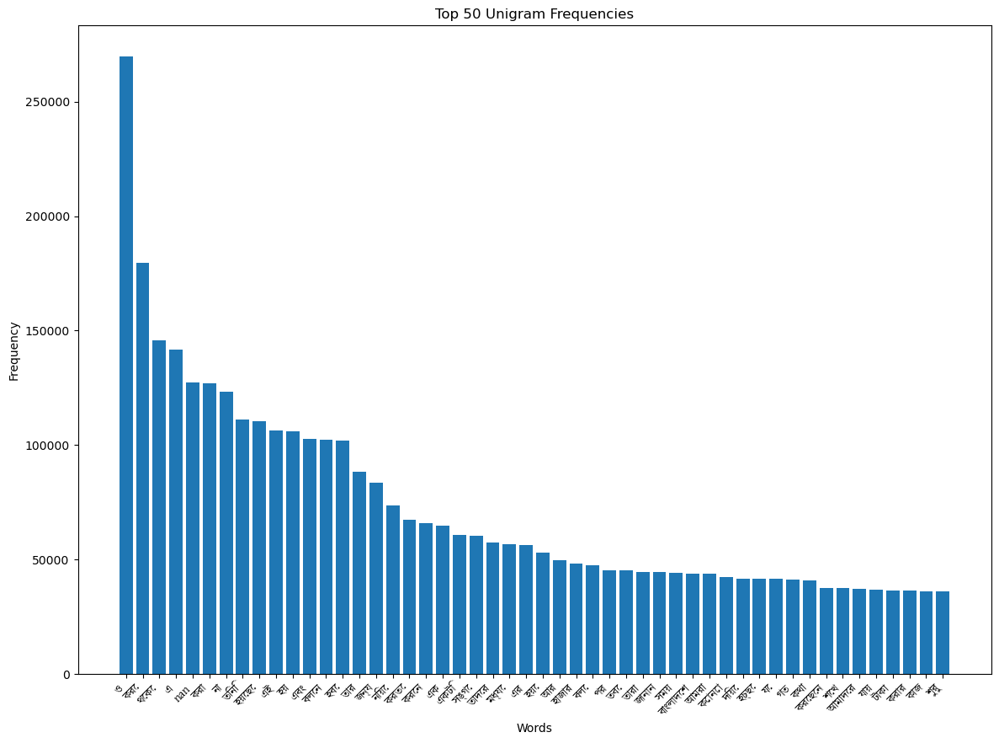

In [1]:
import pandas as pd
import re
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.font_manager as fm

def clean_text(text):
    cleaned_text = re.sub("[:+—–_(){}\n;|.,?’!@<>।॥“”'\"\\[\\]]", ' ', text)
    return cleaned_text

# Load CSV data into a DataFrame
data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path

# Extract the column containing the text data
text_column = data['news_description']  # Replace "text_column_name" with the actual column name

# Convert non-string values to strings and clean the text
cleaned_texts = [clean_text(str(text)) for text in text_column]

# Combine all cleaned text data into a single string
all_text = ' '.join(cleaned_texts)

# Tokenize into words
words = all_text.split()

# Calculate word frequencies
word_freq = Counter(words)

# Get the top 50 words
top_words = dict(sorted(word_freq.items(), key=lambda item: item[1], reverse=True)[:50])

# Specify a font that supports Unicode characters
font_path = fm.findfont(fm.FontProperties(family="kalpurush"))

# Create a bar chart with the specified font and larger figsize
plt.figure(figsize=(14, 10))  # Larger figsize
plt.bar(top_words.keys(), top_words.values())
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.title("Top 50 Unigram Frequencies")

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right', fontproperties=fm.FontProperties(fname=font_path))

# Specify the absolute file path to save the PNG image on your PC
output_file_path = "D:/DM_LAB/top_50_unigrams.png"  # Replace with your desired file path

# Save the bar chart as a PNG file
plt.savefig(output_file_path, format="png", bbox_inches="tight", pad_inches=0.5, dpi=300)

# Show the plot (optional)
plt.show()


In [2]:
len(word_freq)

395772

C:\Users\mushf\AppData\Local\Temp\ipykernel_10364\3036882228.py:13: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path


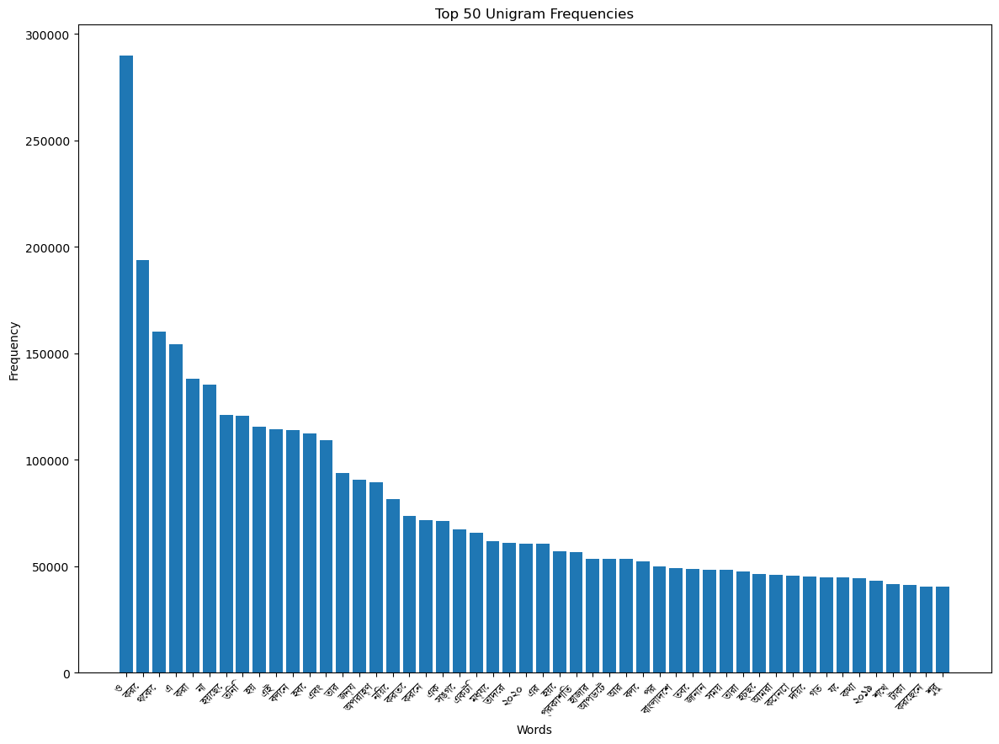

In [3]:
import pandas as pd
import re
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.font_manager as fm

def clean_text(text):
    cleaned_text = re.sub("[:+—–_(){}\n;|.,?’!@<>।॥“”'\"\\[\\]]", ' ', text)
    return cleaned_text

# Load CSV data into a DataFrame
data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path

# Extract the columns containing the text data
text_column = data['news_description']  # Replace "news_description" with the actual column name
title_column = data['news_title']  # Replace "news_title" with the actual column name
date_column = data['date']  # Replace "date" with the actual column name

# Convert non-string values to strings and clean the text
cleaned_texts = [clean_text(str(text)) for text in text_column]
cleaned_titles = [clean_text(str(title)) for title in title_column]
cleaned_dates = [clean_text(str(date)) for date in date_column]

# Combine all cleaned text data into a single string
all_text = ' '.join(cleaned_texts + cleaned_titles + cleaned_dates)

# Tokenize into words
words = all_text.split()

# Calculate word frequencies
word_freq = Counter(words)

# Filter out NaN values from the word frequencies
word_freq = {word: freq for word, freq in word_freq.items() if isinstance(word, str) and word.lower() != 'nan'}

# Get the top 50 words
top_words = dict(sorted(word_freq.items(), key=lambda item: item[1], reverse=True)[:50])

# Specify a font that supports Unicode characters
font_path = fm.findfont(fm.FontProperties(family="kalpurush"))

# Create a bar chart with the specified font and larger figsize
plt.figure(figsize=(14, 10))  # Larger figsize
plt.bar(top_words.keys(), top_words.values())
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.title("Top 50 Unigram Frequencies")

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right', fontproperties=fm.FontProperties(fname=font_path))

# Specify the absolute file path to save the PNG image on your PC
output_file_path = "D:/DM_LAB/top_50_unigrams-all.png"  # Replace with your desired file path

# Save the bar chart as a PNG file
plt.savefig(output_file_path, format="png", bbox_inches="tight", pad_inches=0.5, dpi=300)

# Show the plot (optional)
plt.show()


In [4]:
len(word_freq)

411046

In [2]:
import pandas as pd
from collections import Counter

# Load CSV data into a DataFrame
data = pd.read_csv("/media/mushfiq/Academic/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path

# Extract the columns containing the text data
text_column = data['news_description']  # Replace "news_description" with the actual column name
title_column = data['news_title']  # Replace "news_title" with the actual column name
date_column = data['date']  # Replace "date" with the actual column name

# Convert the text data to lowercase strings
text_strings = text_column.astype(str).str.lower()
title_strings = title_column.astype(str).str.lower()
date_strings = date_column.astype(str).str.lower()

# Combine all text data into a single string
all_text = ' '.join(text_strings + title_strings + date_strings)

# Tokenize into words
words = all_text.split()

# Calculate word frequencies
word_freq = Counter(words)

# Filter out unwanted words (punctuation and "nan")
unwanted_words = ['nan', ',']  # Add more words to this list if needed
filtered_word_freq = {word: freq for word, freq in word_freq.items() if word not in unwanted_words and freq>=5}

# Sort the words by frequency in descending order
sorted_word_freq = sorted(filtered_word_freq.items(), key=lambda x: x[1], reverse=True)

# Display all words and their frequencies
for word, freq in sorted_word_freq:
    print(f"{word}: {freq}")

# Optionally, you can save all words and frequencies to a CSV file
all_words_df = pd.DataFrame(sorted_word_freq, columns=["Word", "Frequency"])
all_words_df.to_csv("all_words.csv", index=False)


/tmp/ipykernel_165974/752976188.py:5: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("/media/mushfiq/Academic/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path


ও: 288868
করে: 166785
থেকে: 156104
এ: 140796
করা: 132498
এই: 110786
এবং: 108840
তার: 90529
বলেন,: 89966
অপরাহ্ণ: 89562
জন্য: 86046
নিয়ে: 79507
তিনি: 77268
করতে: 72062
না: 70305
এক: 69156
সঙ্গে: 65383
একটি: 64676
মধ্যে: 60505
২০২০: 60220
তাদের: 58809
হয়েছে।: 58029
হয়ে: 56241
হয়।: 53125
প্রকাশিত:: 53016
আপডেট:: 53016
এর: 52758
হাজার: 52385
আর: 52195
বলে: 50523
পর: 49289
সময়: 46944
কোনো: 45317
হবে।: 45177
আমরা: 44158
না।: 43914
দিয়ে: 43638
তবে: 43320
২০১৯: 42495
কথা: 41262
বাংলাদেশ: 40260
হবে: 39593
শুরু: 39255
করার: 38920
শেখ: 38885
গত: 38852
যে: 38231
আমাদের: 37951
তারা: 37690
বিভিন্ন: 37488
কাজ: 37272
কিন্তু: 36056
দেশের: 35581
করোনা: 34442
পর্যন্ত: 34374
হিসেবে: 33931
আগে: 33525
হয়েছে: 33092
এখন: 32993
করেন: 32384
তা: 32099
দুই: 32009
সব: 31600
নতুন: 31065
হয়: 30928
টাকা: 30175
লাখ: 30164
ওই: 29568
সেই: 28755
প্রধানমন্ত্রী: 28667
কারণে: 27489
প্রথম: 27234
বছর: 27135
বা: 26822
দেয়া: 26699
তাকে: 26638
দেখা: 26320
মাধ্যমে: 26275
ঢাকা: 26110
আমি: 25931
জাতীয়: 25799
কিছু: 25553
অনেক: 25536

In [2]:
import pandas as pd
from collections import Counter
import json

# Load CSV data into a DataFrame
data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path

# Extract the columns containing the text data
text_column = data['news_description']  # Replace "news_description" with the actual column name
title_column = data['news_title']  # Replace "news_title" with the actual column name
date_column = data['date']  # Replace "date" with the actual column name

# Convert the text data to lowercase strings
text_strings = text_column.astype(str).str.lower()
title_strings = title_column.astype(str).str.lower()
date_strings = date_column.astype(str).str.lower()

# Combine all text data into a single string
all_text = ' '.join(text_strings + title_strings + date_strings)

# Tokenize into words
words = all_text.split()

# Calculate word frequencies
word_freq = Counter(words)

# Filter out unwanted words (punctuation and "nan")
unwanted_words = ['nan', ',']  # Add more words to this list if needed
filtered_word_freq = {word: freq for word, freq in word_freq.items() if word not in unwanted_words}

# Create a dictionary with words and their frequencies
word_dictionary = {word: freq for word, freq in filtered_word_freq.items() if freq > 1}

# Optionally, you can save the dictionary to a JSON file
with open("word_dictionary.json", "w") as json_file:
    json.dump(word_dictionary, json_file, indent=4)

# Sort the words by frequency in descending order
sorted_word_freq = sorted(word_dictionary.items(), key=lambda x: x[1], reverse=True)

# Display all words and their frequencies
for word, freq in sorted_word_freq:
    print(f"{word}: {freq}")

# Optionally, you can save all words and frequencies to a CSV file
all_words_df = pd.DataFrame(sorted_word_freq, columns=["Word", "Frequency"])
all_words_df.to_csv("all_words.csv", index=False)


C:\Users\mushf\AppData\Local\Temp\ipykernel_11832\3551997861.py:6: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("D:/DM_LAB/merged_data.csv")  # Replace "your_data.csv" with your file path


ও: 288868
করে: 166785
থেকে: 156104
এ: 140796
করা: 132498
এই: 110786
এবং: 108840
তার: 90529
বলেন,: 89966
অপরাহ্ণ: 89562
জন্য: 86046
নিয়ে: 79507
তিনি: 77268
করতে: 72062
না: 70305
এক: 69156
সঙ্গে: 65383
একটি: 64676
মধ্যে: 60505
২০২০: 60220
তাদের: 58809
হয়েছে।: 58029
হয়ে: 56241
হয়।: 53125
প্রকাশিত:: 53016
আপডেট:: 53016
এর: 52758
হাজার: 52385
আর: 52195
বলে: 50523
পর: 49289
সময়: 46944
কোনো: 45317
হবে।: 45177
আমরা: 44158
না।: 43914
দিয়ে: 43638
তবে: 43320
২০১৯: 42495
কথা: 41262
বাংলাদেশ: 40260
হবে: 39593
শুরু: 39255
করার: 38920
শেখ: 38885
গত: 38852
যে: 38231
আমাদের: 37951
তারা: 37690
বিভিন্ন: 37488
কাজ: 37272
কিন্তু: 36056
দেশের: 35581
করোনা: 34442
পর্যন্ত: 34374
হিসেবে: 33931
আগে: 33525
হয়েছে: 33092
এখন: 32993
করেন: 32384
তা: 32099
দুই: 32009
সব: 31600
নতুন: 31065
হয়: 30928
টাকা: 30175
লাখ: 30164
ওই: 29568
সেই: 28755
প্রধানমন্ত্রী: 28667
কারণে: 27489
প্রথম: 27234
বছর: 27135
বা: 26822
দেয়া: 26699
তাকে: 26638
দেখা: 26320
মাধ্যমে: 26275
ঢাকা: 26110
আমি: 25931
জাতীয়: 25799
কিছু: 25553
অনেক: 25536